# Bimodal distribution with correlations
### Notebook

--- 

In [1]:
using Revise, DrWatson
@quickactivate

In [2]:
using main
using BlockDiagonals, LinearAlgebra, Pipe, Plots, ProgressMeter
using Distributions, MCMCChains, NNlib, Random, StatsBase, Zygote, ForwardDiff

gr(fmt=:png, levels=5, lw=0.1, msa=0.1, msw=0.5, ma=0.2, msc=:firebrick1, legend=:topright)
ProgressMeter.ijulia_behavior(:clear);

Precompiling 

main


  ✓ MultivariateStats


  ✓ DistributionsAD → DistributionsADForwardDiffExt


  ✓ Clustering


  ✓ StatsPlots


  ✓ MathOptInterface


  ✓ Optim


  ✓ main
  7 dependencies successfully precompiled in 37 seconds. 320 already precompiled.


[ Info: Precompiling IJuliaExt [2f4121a4-3b3a-5ce6-9c5e-1f2673ce168a]


In [4]:
function generate_model(; m = 2.0, d = 10, s=0.75, method=:reverse)
    R = prod(
        [
        BlockDiagonal(
            [diagm(ones(2j)),
            [0.0 -1.0; 1.0 0.0],
            diagm(ones(d - 2j - 2))]
        ) for j in 0:round(Int, d / 2 - 1)
    ]
    )
    Σ₁ = [s^abs(i - j) for i in 1:d, j in 1:d]
    Σ₂ = R * Σ₁ * R'
    μ = [-m .* ones(d), m .* ones(d)]
    Σ = [Σ₁, Σ₂]

    ξ = MixtureModel(
        [MvNormal(x, y) for (x, y) in zip(μ, Σ)]
    )
    S = [inv(s) for s in Σ]
    
    f(x) = [-dot(x-m, s, x-m) for (m, s) in zip(μ, S)] .|> exp |> sum
    U(x) = -logsumexp([-dot(x-m, s, x-m) for (m, s) in zip(μ, S)])
    DU(x) = Zygote.gradient(U, x)[1]
    
    return Model(ξ=ξ, f=f, U=U, dU=DU)
end

generate_model (generic function with 1 method)

#### Wasserstein metric and Plot functions


In [5]:
function bures(m1, m2, s1, s2)
    a = norm(m1 - m2)^2
    b = tr(sqrt(sqrt(s1) * s2 * sqrt(s1)))
    c = tr(s1) + tr(s2) - 2 * b
    return sqrt(a + c)
end

function w2(X)
    if typeof(X) <: Tuple
        Y = rand(model.ξ, size(X[1], 1))' |> Matrix
        Z = X[1]
        return bures(mean(Z), mean(Y), cov(Z), cov(Y))
    else
        Y = rand(model.ξ, size(X, 1))' |> Matrix
        return bures(mean(X), mean(Y), cov(X), cov(Y))
    end
end

w2 (generic function with 1 method)

In [6]:
function scatterplot(x; baseplt=plot(0,0,label=""), label="", kwargs...)
    if typeof(x) <: Tuple
        plt = plot(baseplt, x[1] |> m2t, c=:black, lw=0.1, la=0.25, label="")
        plt = scatter(plt, x[1] |> m2t, ms=exp.(2 .* standardize(UnitRangeTransform, x[2])), label=label, c=:orange; kwargs...)
    else
        plt = plot(baseplt, x |> m2t, c=:black, lw=0.1, la=0.25, label="")
        plt = scatter(plt, x |> m2t, c=:orange, label=label; kwargs...)
    end
    return plt
end

function acfplots(chains, names, lags=0:2:50; kwargs...)
    plt = plot(0, 0)
    for (x, n) in zip(chains, names)
        plt = plot(plt, mean(1 .* (autocor(x, lags=[lags...])[:, :]), dims=1)', label=n; kwargs...)
    end
    return plt
end

function scatterplots(xs, names; baseplt=plot(0,0,label=nothing), l=400, kwargs...)
    L = length(xs)
    ds = sample(1:size(xs[1], 2), 2, replace=false)
    plts = [scatter(baseplt, x[:, ds[1]], x[:, ds[2]], label=names[i]) for (x, i) in zip(xs, eachindex(xs))]
    plot(plts..., axes=false, ticks=false; kwargs...)
end

function traceplots(xs, names, args...; baseplt=plot(0,0,label=nothing), l=400, kwargs...)
    L = length(xs)
    ds = sample(1:size(xs[1], 2), 1, replace=false)
    plts = [plot( (typeof(x) <: Tuple ? x[1][:, ds[1]] : x[:, ds[1]]), label=names[i]; args...) for (x, i) in zip(xs, eachindex(xs))]
    plot(plts...; kwargs...)
end

function mean_ess(chains)
    return [ess_rhat(chn)[:, 2] |> mean for chn in chains]
end

mean_ess (generic function with 1 method)

<br><br><br>

---

# Example: $\mathbb R^{2}$

In [7]:
model = generate_model(d=2);

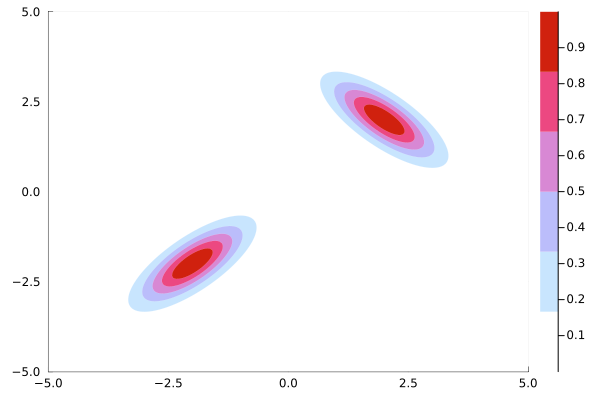

In [8]:
cls = palette(:linear_wcmr_100_45_c42_n256, 100, rev=false)
plt(; lim=(-5, 5)) = contourf(
    repeat([range(lim..., length=200)], 2)..., 
    (x, y) -> model.f([x; y]),
    c=cls
)
plt2 = plt()

Progress: 100%|█████████████████████████████████████████| Time: 0:00:03
  HMC(0.555101465906103, 18, Any[]):  0.729254149170166


Acceptance Ratio = 0.7293
  3.595742 seconds (22.26 M allocations: 1.370 GiB, 4.09% gc time, 83.34% compilation time)


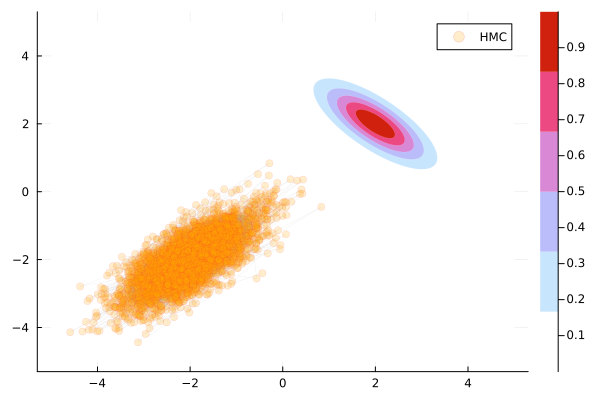

In [9]:
@time s1, a1 = mcmc(
    DualAverage(λ=10.0, δ=0.65),
    HMC(),
    model; n=5e3, n_burn=1e3
)
x_hmc = s1[a1, :]
chain_hmc = Chains(x_hmc)
plt2_hmc = scatterplot(x_hmc[:, 1:2], baseplt=plt(), label="HMC")

Progress: 100%|█████████████████████████████████████████| Time: 0:00:05
  RAHMC(0.24320665505050623, 82, 0.6128331324830506, Any[]):  0.46870625874825034


Acceptance Ratio = 0.4687
  5.679942 seconds (128.94 M allocations: 7.675 GiB, 8.72% gc time, 3.63% compilation time)


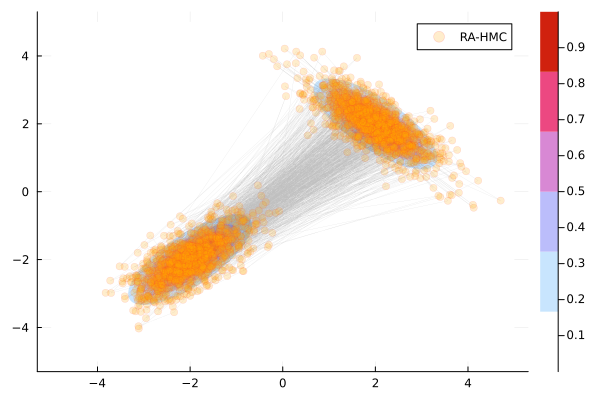

In [10]:
@time s2, a2 = mcmc(
    DualAverage(λ=20.0, δ=0.65),
    RAHMC(),
    model; n=5e3, n_burn=1e3
)
x_rahmc = s2[a2, :]
chain_rahmc = Chains(x_rahmc)
plt2_rahmc = scatterplot(x_rahmc[:, 1:2], baseplt=plt(), label="RA-HMC")

Progress: 100%|█████████████████████████████████████████| Time: 0:00:00
  RAM(ZeroMeanIsoNormal(
dim: 2
μ: Zeros(2)
Σ: [2.25 0.0; 0.0 2.25]
)
, [-2.289172957167186, -0.014557360401551853], Any[]):       0.32994500916513914


Acceptance Ratio = 0.3313
  0.223316 seconds (1.67 M allocations: 104.131 MiB, 7.78% gc time, 81.64% compilation time)


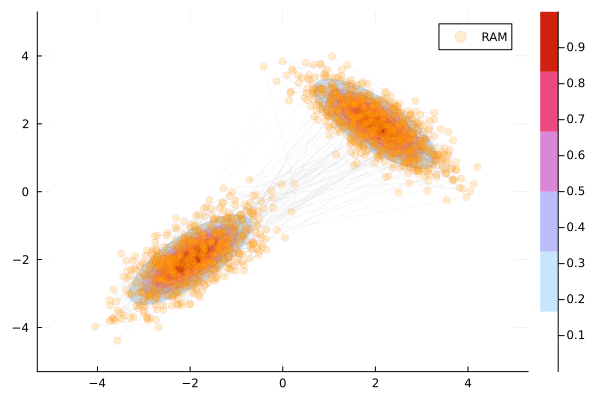

In [11]:
@time s3, a3 = mcmc(
    RAM(kernel=MvNormal(model.d, 1.5), z=randn(model.d)),
    model; n=5e3, n_burn=1e3
)
x_ram = s3[a3, :]
chain_ram = Chains(x_ram)
plt2_ram = scatterplot(x_ram[:, 1:2], baseplt=plt(), label="RAM")

Progress: 100%|█████████████████████████████████████████| Time: 0:00:21
  PEHMC:  0.9019963702359347


Acceptance Ratio = 0.8846
 21.441774 seconds (444.81 M allocations: 27.358 GiB, 8.34% gc time, 9.71% compilation time)


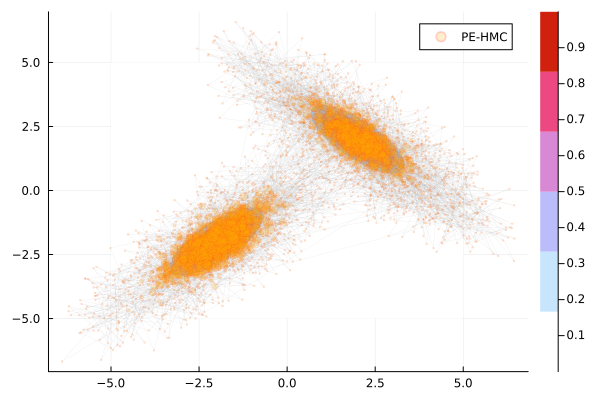

In [12]:
@time s4, w4, a4 = mcmc(
    PEHMC(ϵ=0.1, L=20, N=100),
    model; n=50, n_burn=500
)
x_pehmc, w_pehmc = [s4[a4, :]...] |> a2m, [w4[a4, :]...]
chain_pehmc = Chains(x_pehmc)
plt2_pehmc = scatterplot((x_pehmc, w_pehmc), baseplt=plt(), label="PE-HMC")

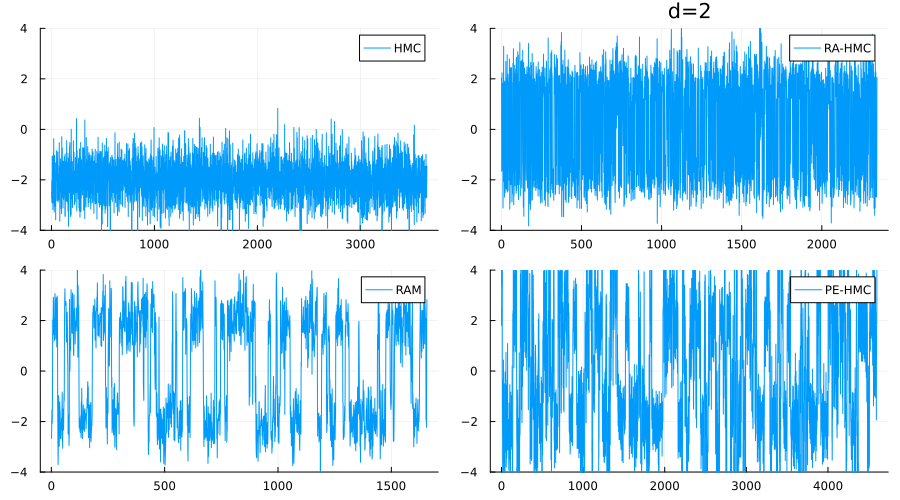

In [13]:
names = ("HMC", "RA-HMC", "RAM", "PE-HMC")
xs2d = [x_hmc, x_rahmc, x_ram, (x_pehmc, w_pehmc)]
chains2d = [chain_hmc, chain_rahmc, chain_ram, chain_pehmc];

plt2_tr = traceplots(xs2d, names, lw=1, layout=(2,2), ylim=(-4,4), l=100, size=(900, 500), title=["" "d=2" "" ""])

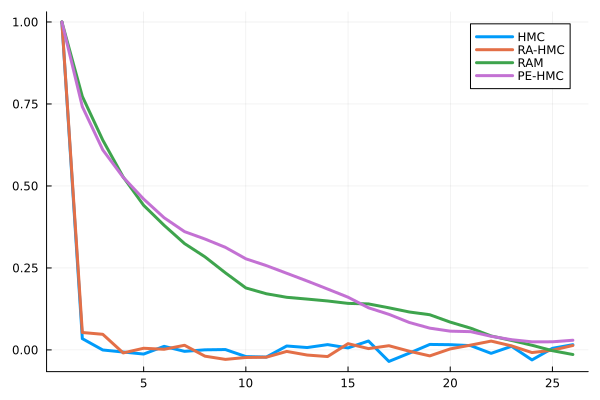

In [14]:
plt2_acf = acfplots(chains2d, names, lw=3)

In [15]:
mean_ess(chains2d)

4-element Vector{Float64}:
 4070.277727887499
 1734.2042014145861
   94.4531351373351
  196.05947306321923

In [16]:
w2.(xs2d)

4-element Vector{Float64}:
 2.9462435547325985
 0.3980468873394346
 0.31703142195179296
 0.5537479335105714

<br><br><br>

---

# Example: $\mathbb R^{10}$

In [17]:
model = generate_model(d=10);

Progress: 100%|█████████████████████████████████████████| Time: 0:00:01
  HMC(0.25382707384299796, 39, Any[]):  0.9004199160167966


Acceptance Ratio = 0.9004
  1.410073 seconds (26.22 M allocations: 2.227 GiB, 12.92% gc time, 0.39% compilation time)


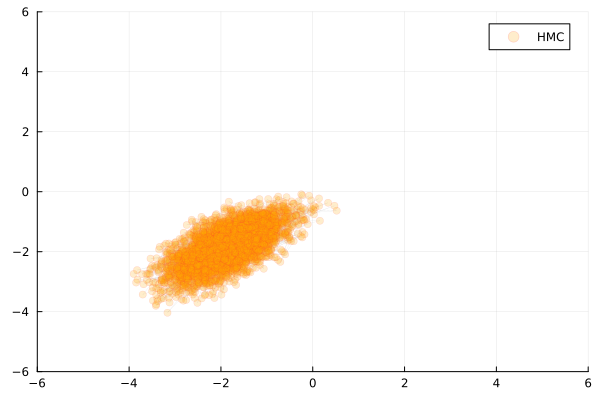

In [18]:
@time s1, a1 = mcmc(
    DualAverage(λ=10, δ=0.6),
    HMC(),
    model; n=5e3, n_burn=1e3
)
x_10_hmc = s1[a1, :]
chain_10_hmc = Chains(x_10_hmc)
plt10_hmc = scatterplot(x_10_hmc[:, 1:2], lim=(-6, 6), label="HMC")

Progress: 100%|█████████████████████████████████████████| Time: 0:00:15
  RAHMC(0.07380705768870534, 271, 0.21265953579941496, Any[]):  0.8318336332733454


Acceptance Ratio = 0.8318
 15.917131 seconds (309.58 M allocations: 26.839 GiB, 12.06% gc time)


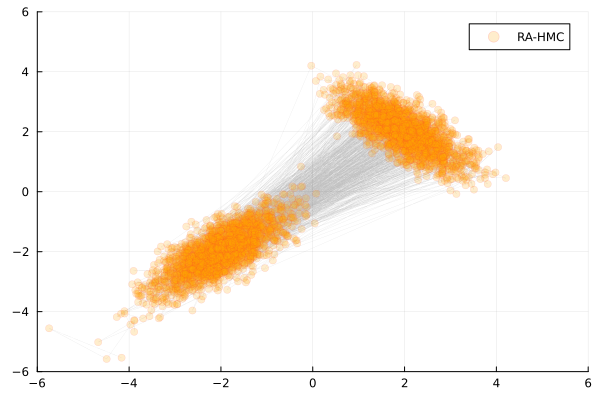

In [19]:
@time s2, a2 = mcmc(
    DualAverage(λ=20.0, δ=0.65),
    RAHMC(),
    model; n=5e3, n_burn=1e2
)
x_10_rahmc = s2[a2, :]
chain_10_rahmc = Chains(x_10_rahmc)
plt10_rahmc = scatterplot(x_10_rahmc[:, 1:2], lim=(-6, 6), label="RA-HMC")

Acceptance Ratio = 0.1194
  0.059471 seconds (1.26 M allocations: 101.232 MiB, 11.74% gc time)


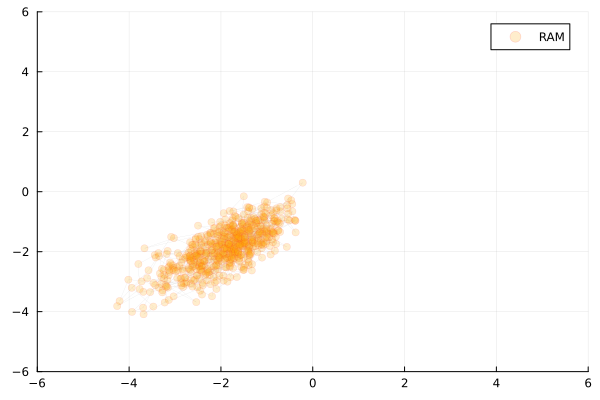

In [20]:
@time s3, a3 = mcmc(
    RAM(kernel=MvNormal(model.d, 0.5), z=randn(model.d)),
    model; n=5e3, n_burn=1e3
)
x_10_ram = s3[a3, :]
chain_10_ram = Chains(x_10_ram)
plt10_ram = scatterplot(x_10_ram[:, 1:2], lim=(-6, 6), label="RAM")

Progress: 100%|█████████████████████████████████████████| Time: 0:00:05
  PEHMC:  0.7218543046357616


Acceptance Ratio = 0.5962
  5.022979 seconds (91.15 M allocations: 9.894 GiB, 12.78% gc time)


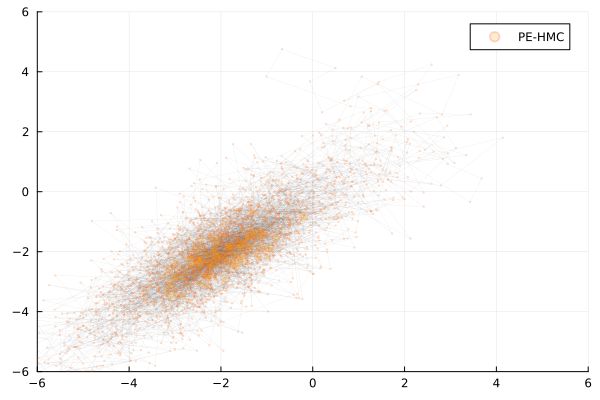

In [21]:
@time s4, w4, a4 = mcmc(
    PEHMC(ϵ=0.08, L=15, N=100),
    model; n=5e1, n_burn=1e2
)
x_10_pehmc, w_10_pehmc = [s4[a4, :]...] |> a2m, [w4[a4, :]...]
chain_10_pehmc = Chains(x_10_pehmc)
plt10_pehmc = scatterplot((x_10_pehmc[:, 1:2], w_10_pehmc), label="PE-HMC", lim=(-6, 6))

In [22]:
xs10d = [x_10_hmc, x_10_rahmc, x_10_ram, (x_10_pehmc, w_10_pehmc)]
chains10d = [chain_10_hmc, chain_10_rahmc, chain_10_ram, chain_10_pehmc];

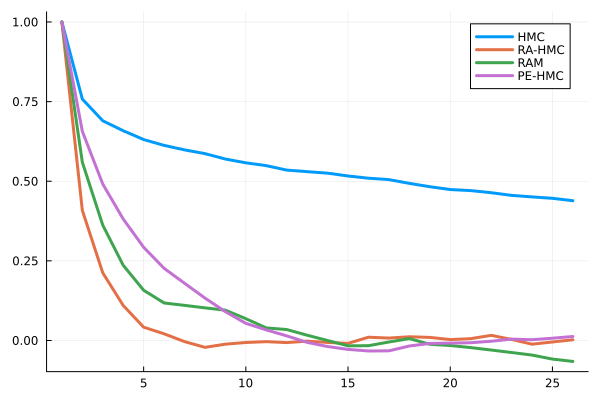

In [23]:
plt10_acf = acfplots(chains10d, names, lw=3)

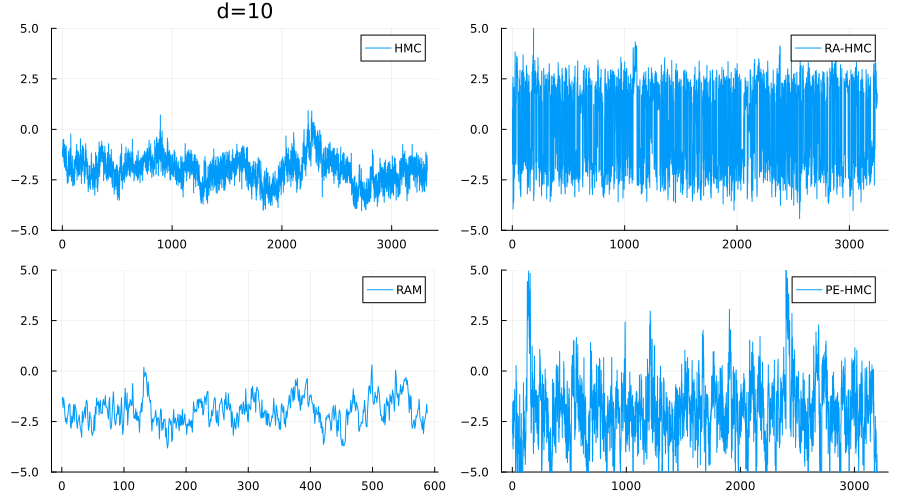

In [24]:
plt10_tr = traceplots(xs10d, names, lw=1, layout=(2,2), ylim=(-5,5), l=100, size=(900, 500), title=["d=$(model.d)" "" "" ""])

In [24]:
mean_ess(chains10d)

4-element Vector{Float64}:
  63.30769815388571
 784.5051313526175
  78.10663136125204
 290.7832988986673

In [25]:
w2.(xs10d)

4-element Vector{Float64}:
 5.811826647275282
 0.8749932987737998
 5.847660643669911
 3.9868289821322533

<br><br><br>

---

# Example: $\mathbb R^{20}$

In [26]:
model = generate_model(d=20);

Progress: 100%|█████████████████████████████████████████| Time: 0:00:01
  HMC(0.355824716415011, 28, Any[]):  0.6256748650269947


Acceptance Ratio = 0.6257
  1.464622 seconds (20.43 M allocations: 2.908 GiB, 21.97% gc time)


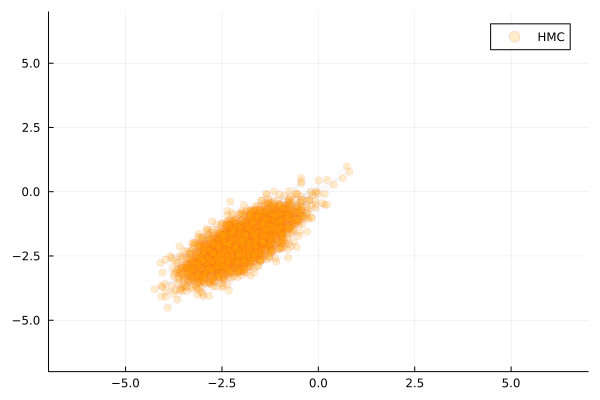

In [27]:
@time s1, a1 = mcmc(
    DualAverage(λ=10, δ=0.6),
    HMC(),
    model; n=5e3, n_burn=1e3
)
x_20_hmc = s1[a1, :]
chain_20_hmc = Chains(x_20_hmc)
plt20_hmc = scatterplot(x_20_hmc[:, 1:2], label="HMC", lim=(-7, 7))

Progress: 100%|█████████████████████████████████████████| Time: 0:00:52
  RAHMC(0.06573278841301468, 609, 0.2096149736410152, Any[]):  0.7826434713057389


Acceptance Ratio = 0.7826
 52.256962 seconds (847.26 M allocations: 123.745 GiB, 13.53% gc time)


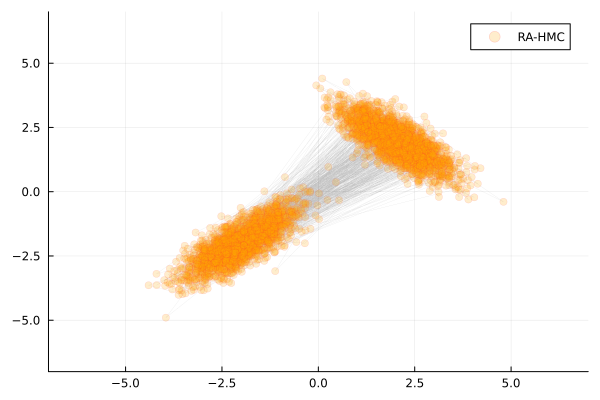

In [28]:
@time s2, a2 = mcmc(
    DualAverage(λ=40.0, δ=0.65),
    RAHMC(),
    model; n=5e3, n_burn=1e3
)
x_20_rahmc = s2[a2, :]
chain_20_rahmc = Chains(x_20_rahmc)
plt20_rahmc = scatterplot(x_20_rahmc[:, 1:2], label="RA-HMC", lim=(-7, 7))

Acceptance Ratio = 0.4492
  0.046414 seconds (906.58 k allocations: 98.683 MiB)


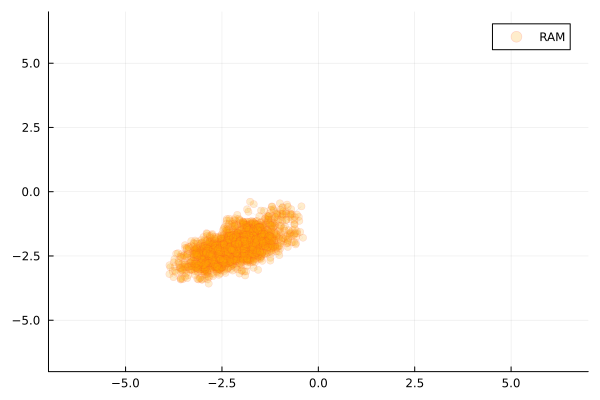

In [29]:
@time s3, a3 = mcmc(
    RAM(kernel=MvNormal(model.d, 0.12), z=randn(model.d)),
    model; n=5e3, n_burn=1e3
)
x_20_ram = s3[a3, :]
chain_20_ram = Chains(x_20_ram)
plt20_ram = scatterplot(x_20_ram[:, 1:2], lim=(-7, 7), label="RAM")

Progress: 100%|█████████████████████████████████████████| Time: 0:00:18
  PEHMC:  0.9602649006622517


Acceptance Ratio = 0.9423
 18.802874 seconds (237.14 M allocations: 54.557 GiB, 18.03% gc time)


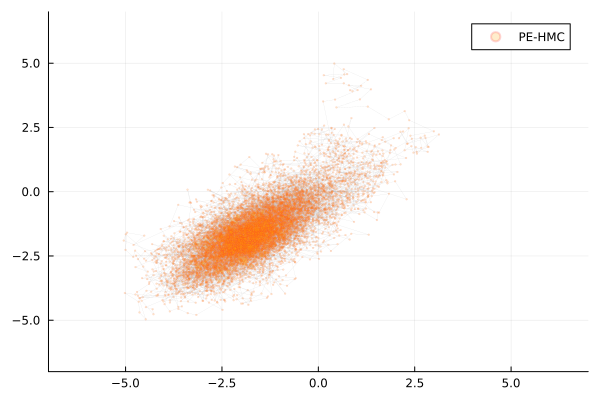

In [30]:
@time s4, w4, a4 = mcmc(
    PEHMC(ϵ=0.02, L=20, N=200),
    model; n=5e1, n_burn=1e2
)
x_20_pehmc, w_20_pehmc = [s4[a4, :]...] |> a2m, [w4[a4, :]...]
chain_20_pehmc = Chains(x_20_pehmc)
plt20_pehmc = scatterplot((x_20_pehmc[:, 1:2], w_20_pehmc), label="PE-HMC", lim=(-7, 7))

In [31]:
xs20d = [x_20_hmc, x_20_rahmc, x_20_ram, (x_20_pehmc, w_20_pehmc)]
chains20d = [chain_20_hmc, chain_20_rahmc, chain_20_ram, chain_20_pehmc];

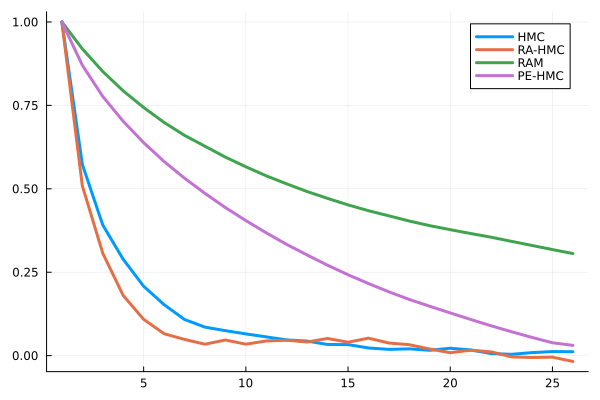

In [32]:
plt20_acf = acfplots(chains20d, names, lw=3)

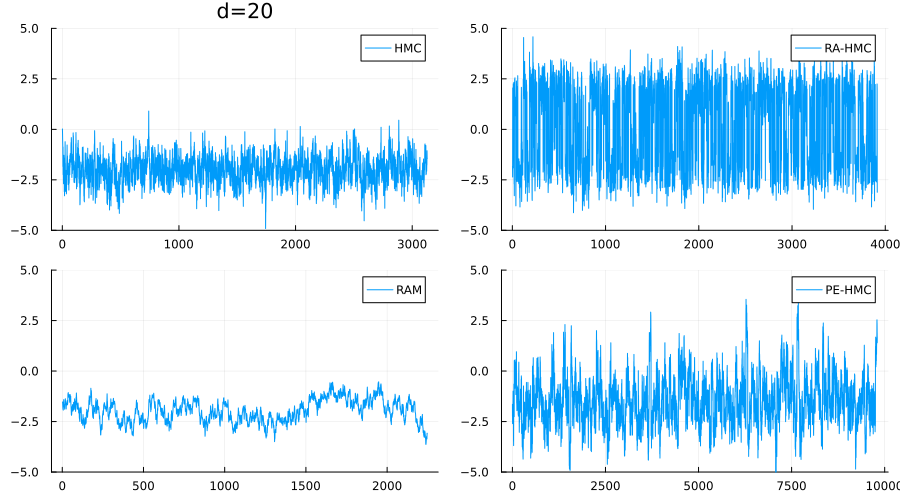

In [33]:
plt20_tr = traceplots(xs20d, names, lw=1, layout=(2,2), ylim=(-5,5), l=100, size=(900, 500), title=["d=$(model.d)" "" "" ""])

In [34]:
mean_ess(chains20d)

4-element Vector{Float64}:
 499.2308784914335
 621.7623142294173
  25.223790731873684
 270.6538448712762

In [35]:
w2.(xs20d)

4-element Vector{Float64}:
 7.993550367016776
 1.2198501122274858
 8.69806122452907
 6.431729369212945

<br><br><br>

---

# Example: $\mathbb R^{50}$

In [36]:
model = generate_model(d=50);

Progress: 100%|█████████████████████████████████████████| Time: 0:00:08
  HMC(0.23978028326773088, 127, Any[]):  0.7198200449887528


Acceptance Ratio = 0.7198
  8.339897 seconds (71.32 M allocations: 33.622 GiB, 15.81% gc time)


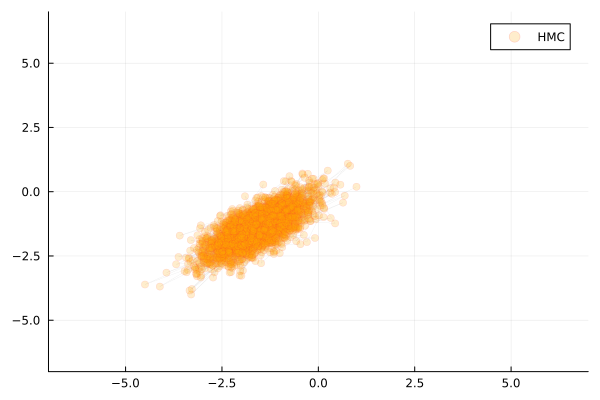

In [37]:
@time s1, a1 = mcmc(
    DualAverage(λ=30.5, δ=0.6),
    HMC(),
    model; n=4e3, n_burn=1e3
)
x_50_hmc = s1[a1, :]
chain_50_hmc = Chains(x_50_hmc)
plt50_hmc = scatterplot(x_50_hmc[:, 1:2], label="HMC", lim=(-7, 7))

Progress: 100%|█████████████████████████████████████████| Time: 0:06:11
  RAHMC(0.025970255091507622, 3466, 0.11494918138885396, Any[]):  0.6923269182704324


Acceptance Ratio = 0.6923
371.150555 seconds (3.48 G allocations: 1.591 TiB, 15.82% gc time)


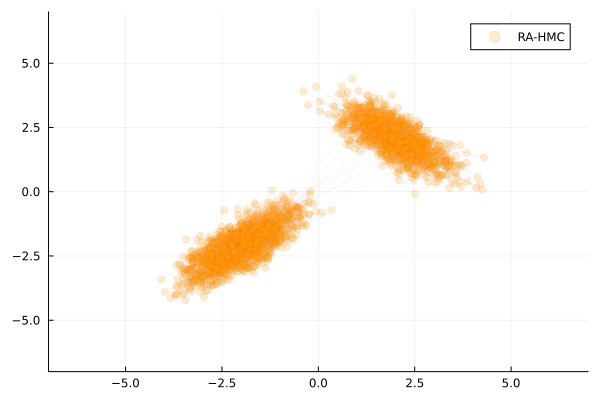

In [38]:
@time s2, a2 = mcmc(
    DualAverage(λ=90.0, δ=0.65),
    RAHMC(),
    model; n=4e3, n_burn=1e3
)
x_50_rahmc = s2[a2, :]
chain_50_rahmc = Chains(x_50_rahmc)
plt50_rahmc = scatterplot(x_50_rahmc[:, 1:2], label="RA-HMC", lim=(-7, 7))

Progress: 100%|█████████████████████████████████████████| Time: 0:00:00
  RAM(ZeroMeanIsoNormal(
dim: 50
μ: Zeros(50)
Σ: [0.0121 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0; 0.0 0.0121 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0; 0.0 0.0 0.0121 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0; 0.0 0.0 0.0 0.0121 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0; 0.0 0.0 0.0 0.0 0.0121 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0

Acceptance Ratio = 0.0
  0.173603 seconds (1.86 M allocations: 386.619 MiB, 4.06% gc time)


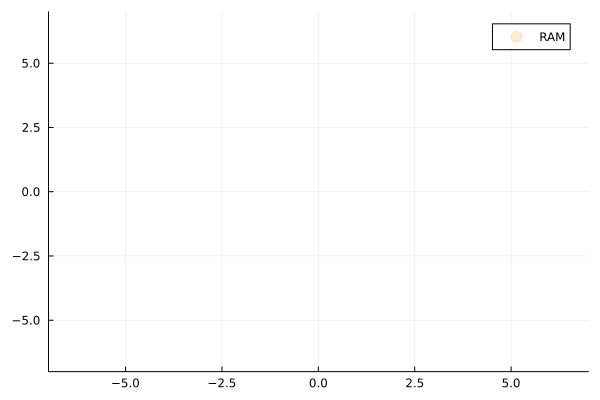

In [39]:
@time s3, a3 = mcmc(
    RAM(kernel=MvNormal(model.d, 0.11), z=randn(model.d)),
    model; n=1e4, n_burn=1e3
)
x_50_ram = s3[a3, :]
chain_50_ram = Chains(x_50_ram)
plt50_ram = scatterplot(x_50_ram[:, 1:2], lim=(-7, 7), label="RAM")

Progress: 100%|█████████████████████████████████████████| Time: 0:00:14
  PEHMC:  0.9470198675496688


Acceptance Ratio = 0.9808
 14.798825 seconds (95.01 M allocations: 86.619 GiB, 18.61% gc time)


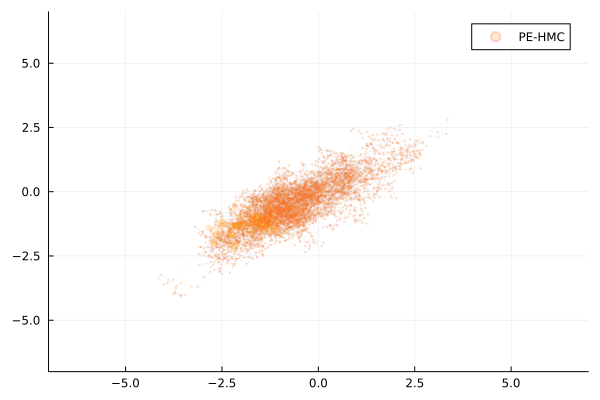

In [40]:
@time s4, w4, a4 = mcmc(
    PEHMC(ϵ=0.012, L=15, N=100),
    model; n=5e1, n_burn=1e2
)
x_50_pehmc, w_50_pehmc = [s4[a4, :]...] |> a2m, [w4[a4, :]...]
chain_50_pehmc = Chains(x_50_pehmc)
plt50_pehmc = scatterplot((x_50_pehmc[:, 1:2], w_50_pehmc), label="PE-HMC", lim=(-7, 7))

In [41]:
xs50d = [x_50_hmc, x_50_rahmc, x_50_ram, (x_50_pehmc, w_50_pehmc)]
chains50d = [chain_50_hmc, chain_50_rahmc, chain_50_ram, chain_50_pehmc];

In [42]:
plt50_acf = acfplots(chains50d, names, lw=3)

LoadError: lags must be less than the sample length.

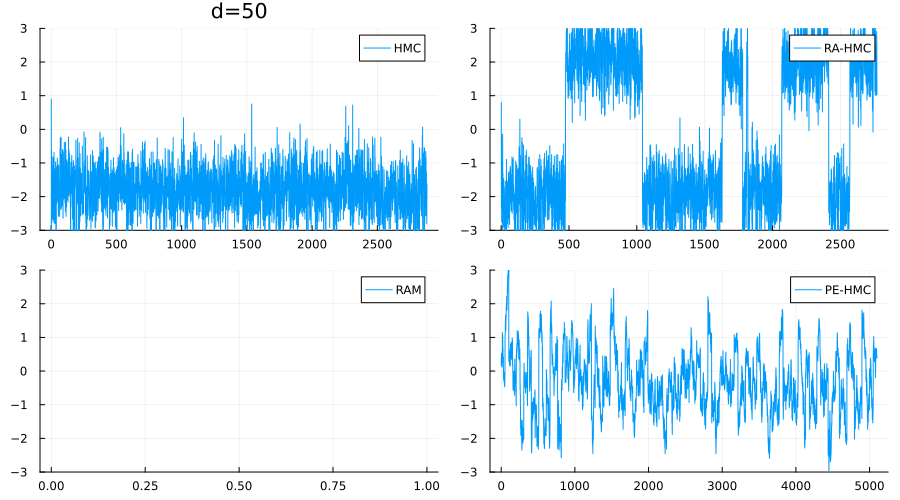

In [43]:
plt50_tr = traceplots(xs50d, names, lw=1, layout=(2,2), ylim=(-3,3), l=100, size=(900, 500), title=["d=$(model.d)" "" "" ""])

In [44]:
mean_ess(chains50d)

LoadError: DivideError: integer division error

In [45]:
w2.(xs50d)

4-element Vector{Float64}:
  13.277809653672024
   2.217429795972236
 NaN
  12.696738973117531

<br><br><br>

---

# Example: $\mathbb R^{100}$

In [46]:
model = generate_model(d=100, s=0.2);

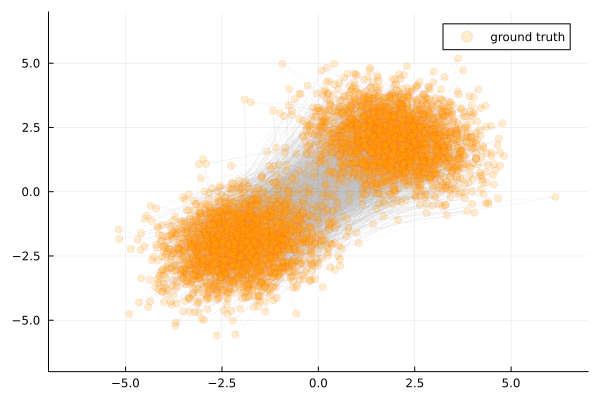

In [47]:
@pipe rand(model.ξ, 5000)[1:2, :]' |> m2t |> scatterplot(_, label="ground truth", lim=(-7, 7))

Progress: 100%|█████████████████████████████████████████| Time: 0:02:49
  HMC(0.17440221411597429, 175, Any[]):  0.9490254872563718


Acceptance Ratio = 0.949
169.041214 seconds (62.66 M allocations: 96.166 GiB, 1.70% gc time)


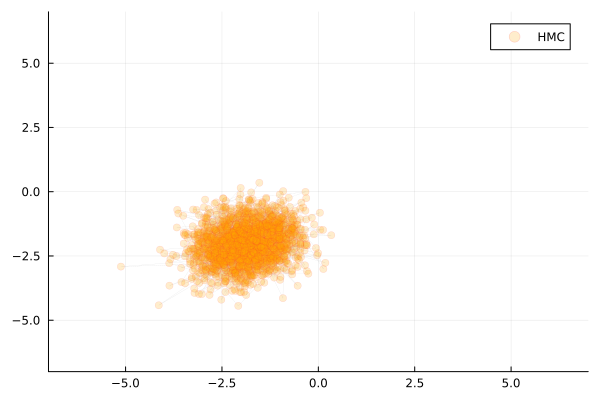

In [48]:
@time s1, a1 = mcmc(
    DualAverage(λ=30.5, δ=0.6),
    HMC(),
    model; n=2e3, n_burn=1e3
)
x_100_hmc = s1[a1, :]
chain_100_hmc = Chains(x_100_hmc)
plt100_hmc = scatterplot(x_100_hmc[:, 1:2], label="HMC", lim=(-7, 7))

Progress: 100%|█████████████████████████████████████████| Time: 1:31:23
  RAHMC(0.014959075803868146, 5348, 0.08912912836408983, Any[]):  0.7096451774112944


Acceptance Ratio = 0.7096
5483.803423 seconds (2.77 G allocations: 4.093 TiB, 1.68% gc time)


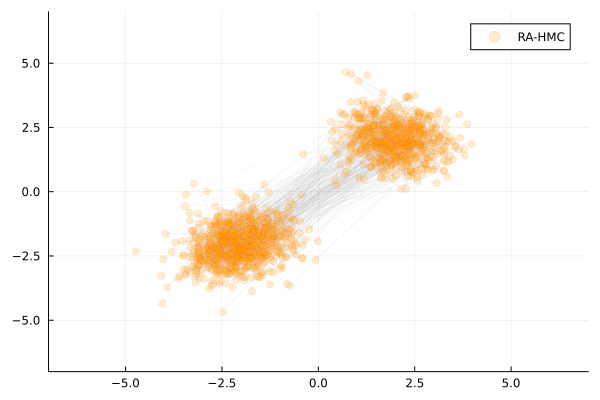

In [55]:
@time s2, a2 = mcmc(
    DualAverage(λ=80.0, δ=0.6),
    RAHMC(),
    model; n=2e3, n_burn=1e3
)
x_100_rahmc = s2[a2, :]
chain_100_rahmc = Chains(x_100_rahmc)
plt100_rahmc = scatterplot(x_100_rahmc[:, 1:2], label="RA-HMC", lim=(-7, 7))

Progress: 100%|█████████████████████████████████████████| Time: 0:00:00
  RAM(ZeroMeanIsoNormal(
dim: 100
μ: Zeros(100)
Σ: [0.005625 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0; 0.0 0.005625 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0; 0.0 0.0 0.005625 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0

Acceptance Ratio = 0.5038
  0.318698 seconds (1.04 M allocations: 296.342 MiB, 23.78% gc time)


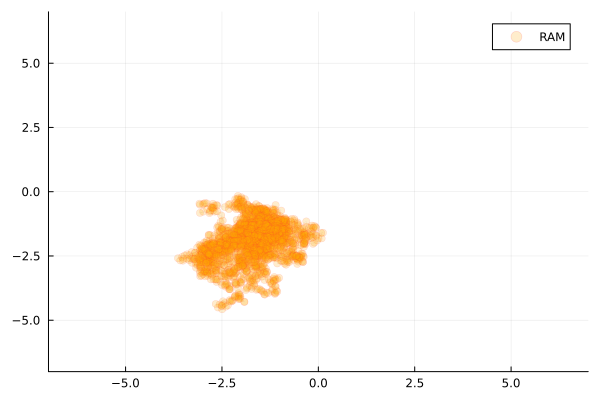

In [56]:
@time s3, a3 = mcmc(
    RAM(kernel=MvNormal(model.d, 0.075), z=randn(model.d)),
    model; n=5e3, n_burn=1e3
)
x_100_ram = s3[a3, :]
chain_100_ram = Chains(x_100_ram)
plt100_ram = scatterplot(x_100_ram[:, 1:2], lim=(-7, 7), label="RAM")

Progress: 100%|█████████████████████████████████████████| Time: 0:03:18
  PEHMC:  0.5033112582781457


Acceptance Ratio = 0.5577
198.275902 seconds (65.62 M allocations: 213.085 GiB, 8.48% gc time)


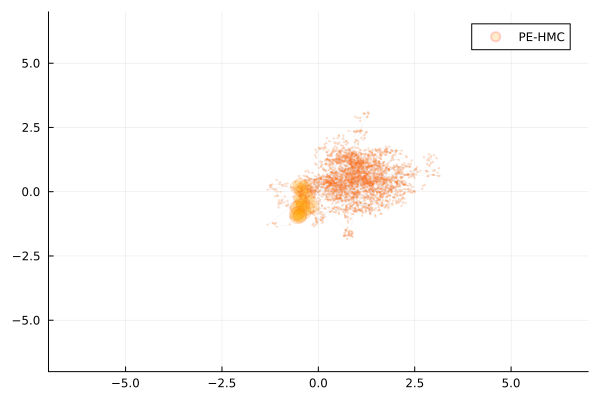

In [57]:
@time s4, w4, a4 = mcmc(
    PEHMC(ϵ=0.01, L=10, N=100),
    model; n=5e1, n_burn=1e2
)
x_100_pehmc, w_100_pehmc = [s4[a4, :]...] |> a2m, [w4[a4, :]...]
chain_100_pehmc = Chains(x_100_pehmc)
plt100_pehmc = scatterplot((x_100_pehmc[:, 1:2], w_100_pehmc), label="PE-HMC", lim=(-7, 7))

In [58]:
xs100d = [x_100_hmc, x_100_rahmc, x_100_ram, (x_100_pehmc, w_100_pehmc)]
chains100d = [chain_100_hmc, chain_100_rahmc, chain_100_ram, chain_100_pehmc];

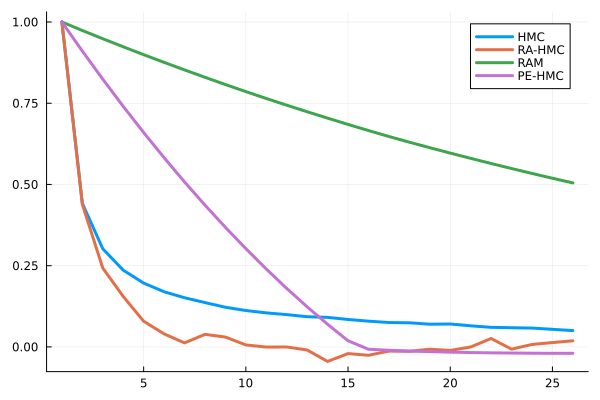

In [59]:
plt100_acf = acfplots(chains100d, names, lw=3, lags=10)

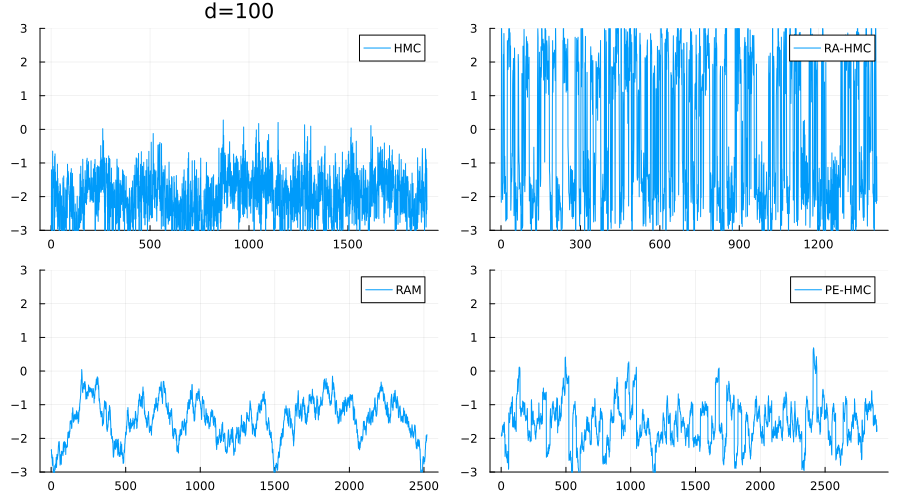

In [60]:
plt100_tr = traceplots(xs100d, names, lw=1, layout=(2,2), ylim=(-3,3), l=100, size=(900, 500), title=["d=$(model.d)" "" "" ""])

In [61]:
mean_ess(chains100d)

4-element Vector{Float64}:
 332.463498540953
 301.0823802259603
  18.522209071980576
 108.2703415803432

In [62]:
w2.(xs100d)

4-element Vector{Float64}:
 19.552401425438067
  3.455555671578274
 20.55817318822644
 19.10601793494334

---